<H1> Capstone - Week 2 </H1>

<b> In the next section we will be scraping data for each of Toronto's neighbourhoods. </b>

In [1]:
#Installing packages
!pip install bs4
from bs4 import BeautifulSoup 
import requests 
import pandas as pd

<h4>Scraping data from Wikipedia</h4>

In [2]:
url = "https://en.wikipedia.org/w/index.php?title=List_of_postal_codes_of_Canada:_M&oldid=1011037969" #using an adjusted url that makes the scraping easier
data  = requests.get(url).text #requesting data
soup = BeautifulSoup(data, 'html5lib') #interpreting data
tables = soup.find_all('table') #pulling data in the table

<h4>Extracting scraped data to a data frame</h4>

In [3]:
neighbourhood_data = pd.DataFrame(columns=["Postal Code", "Borough", "Neighbourhood"]) #setting the headers

#assigning scraped data to columns
for row in tables[0].tbody.find_all("tr"):
    col = row.find_all("td")
    if (col != []):
        postal_code = col[0].text.strip()
        borough = col[1].text.strip()
        neighbourhood = col[2].text.strip()
        neighbourhood_data = neighbourhood_data.append({"Postal Code":postal_code, "Borough":borough, "Neighbourhood":neighbourhood}, ignore_index=True)

indexNames = neighbourhood_data[neighbourhood_data['Borough'] == "Not assigned" ].index #removing unassigned boroughs
neighbourhood_data.drop(indexNames , inplace=True)
neighbourhood_data

,Postal Code,Borough,Neighbourhood
2,M3A,North York,Parkwoods
3,M4A,North York,Victoria Village
4,M5A,Downtown Toronto,"Regent Park, Harbourfront"
5,M6A,North York,"Lawrence Manor, Lawrence Heights"
6,M7A,Downtown Toronto,"Queen's Park, Ontario Provincial Government"
...,...,...,...
160,M8X,Etobicoke,"The Kingsway, Montgomery Road, Old Mill North"
165,M4Y,Downtown Toronto,Church and Wellesley
168,M7Y,East Toronto,"Business reply mail Processing Centre, South C..."
169,M8Y,Etobicoke,"Old Mill South, King's Mill Park, Sunnylea, Hu..."


<b> In the next section we will be importing the corresponding coordinate data for each postal code. </b>

In [4]:
#Pull coordinate info
df_postcode = neighbourhood_data.groupby(['Postal Code', 'Borough'])['Neighbourhood'].apply(', '.join).reset_index()
locgeo_df = pd.read_csv('https://cocl.us/Geospatial_data', index_col='Postal Code')

toronto_data = df_postcode.join(locgeo_df, on='Postal Code') 
toronto_data

,Postal Code,Borough,Neighbourhood,Latitude,Longitude
0,M1B,Scarborough,"Malvern, Rouge",43.806686,-79.194353
1,M1C,Scarborough,"Rouge Hill, Port Union, Highland Creek",43.784535,-79.160497
2,M1E,Scarborough,"Guildwood, Morningside, West Hill",43.763573,-79.188711
3,M1G,Scarborough,Woburn,43.770992,-79.216917
4,M1H,Scarborough,Cedarbrae,43.773136,-79.239476
...,...,...,...,...,...
98,M9N,York,Weston,43.706876,-79.518188
99,M9P,Etobicoke,Westmount,43.696319,-79.532242
100,M9R,Etobicoke,"Kingsview Village, St. Phillips, Martin Grove ...",43.688905,-79.554724
101,M9V,Etobicoke,"South Steeles, Silverstone, Humbergate, Jamest...",43.739416,-79.588437


<b> In the next section we will be performing a cluster analysis to group the neighbourhoods together </b>

In [5]:
#!conda install numpy --yes
import numpy as np # library to handle data in a vectorized manner

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

#!conda install -c conda-forge scikit-learn --yes
# import k-means from clustering stage
from sklearn.cluster import KMeans

!conda install -c conda-forge folium=0.5.0 --yes
import folium # map rendering library


Solving environment: / 
The environment is inconsistent, please check the package plan carefully
The following packages are causing the inconsistency:
- 
  - defaults/noarch::ibm-wsrt-py37main-main==custom=2020
  - defaults/noarch::ibm-wsrt-py37main-keep==0.0.0=2020
  - conda-forge/linux-64::pytorch==1.8.0=cpu_py37hafa7651_0
done

# All requested packages already installed.



In [6]:
#Run Elbow method to optimize K
from scipy.spatial.distance import cdist
toronto_grouped_clustering = toronto_data.drop(['Neighbourhood','Borough','Postal Code'], 1)
distortions = []

K = range(1, 30)
 
for k in K:
    # Building and fitting the model
    kmeans = KMeans(n_clusters=k, random_state=0).fit(toronto_grouped_clustering)
 
    distortions.append(sum(np.min(cdist(toronto_grouped_clustering, kmeans.cluster_centers_,
                                        'euclidean'), axis=1)) / toronto_grouped_clustering.shape[0])

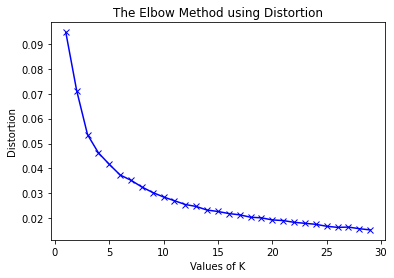

In [7]:
import matplotlib.pyplot as plt
plt.plot(K, distortions, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion')
plt.show()

In [8]:
# set number of clusters
kclusters = 7


# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(toronto_grouped_clustering)

toronto_grouped_clustering = toronto_data
toronto_grouped_clustering.insert(0, 'Cluster Labels', kmeans.labels_) #Add Clusters to df
toronto_postal = toronto_grouped_clustering.copy() #Make a copy that will be used later
toronto_grouped_clustering.head()

,Cluster Labels,Postal Code,Borough,Neighbourhood,Latitude,Longitude
0,5,M1B,Scarborough,"Malvern, Rouge",43.806686,-79.194353
1,5,M1C,Scarborough,"Rouge Hill, Port Union, Highland Creek",43.784535,-79.160497
2,5,M1E,Scarborough,"Guildwood, Morningside, West Hill",43.763573,-79.188711
3,5,M1G,Scarborough,Woburn,43.770992,-79.216917
4,5,M1H,Scarborough,Cedarbrae,43.773136,-79.239476


In [9]:
#Toronto coordinates
latitude = 43.70011
longitude = -79.4163

# Plot neighbourhoods, coloured by cluster
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, cluster in zip(toronto_grouped_clustering['Latitude'], toronto_grouped_clustering['Longitude'], toronto_grouped_clustering['Cluster Labels']):
    label = folium.Popup(' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

In [10]:
toronto_data.head()

,Cluster Labels,Postal Code,Borough,Neighbourhood,Latitude,Longitude
0,5,M1B,Scarborough,"Malvern, Rouge",43.806686,-79.194353
1,5,M1C,Scarborough,"Rouge Hill, Port Union, Highland Creek",43.784535,-79.160497
2,5,M1E,Scarborough,"Guildwood, Morningside, West Hill",43.763573,-79.188711
3,5,M1G,Scarborough,Woburn,43.770992,-79.216917
4,5,M1H,Scarborough,Cedarbrae,43.773136,-79.239476


<b> Pull Resaurant Data from Foursquare API </b>

In [12]:
# The code was removed by Watson Studio for sharing.

In [13]:
VERSION = '20180604'
radius = 1000
LIMIT = 100
section = 'food'
venues = []

for lat, long, neighbourhood in zip(toronto_data['Latitude'], toronto_data['Longitude'], toronto_data['Neighbourhood']):
    # Create the API request URL
    url = "https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&v={}&ll={},{}&section={}&radius={}&limit={}".format(CLIENT_ID,CLIENT_SECRET,VERSION,lat,long,section,radius,LIMIT)
# Make the GET request
    results = requests.get(url).json()['response']['groups'][0]['items']
    for venue in results:
        venues.append((neighbourhood,lat,long,venue['venue']['name'],
        venue['venue']['location']['lat'],venue['venue']['location']['lng'],venue['venue']['categories'][0]['name']))


In [14]:
total_restaurants = pd.DataFrame(venues).shape[0]
total_restaurants #This data will be used later

3733

In [15]:
venues_df = pd.DataFrame(venues)
# Defining the column names
venues_df.columns = ['Neighbourhood', 'Latitude', 'Longitude', 'VenueName', 'VenueLatitude', 'VenueLongitude', 'VenueCategory']
venues_df.head()

,Neighbourhood,Latitude,Longitude,VenueName,VenueLatitude,VenueLongitude,VenueCategory
0,"Malvern, Rouge",43.806686,-79.194353,Harvey's,43.800020,-79.198307,Restaurant
1,"Malvern, Rouge",43.806686,-79.194353,Wendy's,43.802008,-79.198080,Fast Food Restaurant
2,"Malvern, Rouge",43.806686,-79.194353,Wendy’s,43.807448,-79.199056,Fast Food Restaurant
3,"Malvern, Rouge",43.806686,-79.194353,Caribbean Wave,43.798558,-79.195777,Caribbean Restaurant
4,"Malvern, Rouge",43.806686,-79.194353,Bella's Lechon,43.801291,-79.198378,Filipino Restaurant


In [16]:
print('There are {} unique categories.'.format(len(venues_df['VenueCategory'].unique())))
venues_df['VenueCategory'].unique()

There are 114 unique categories.


array(['Restaurant', 'Fast Food Restaurant', 'Caribbean Restaurant',
       'Filipino Restaurant', 'African Restaurant', 'Chinese Restaurant',
       'Greek Restaurant', 'Bakery', 'Sandwich Place',
       'Italian Restaurant', 'Burger Joint', 'Breakfast Spot',
       'Fried Chicken Joint', 'Pizza Place', 'Mexican Restaurant',
       'Donut Shop', 'Fish & Chips Shop', 'Indian Restaurant',
       'Hakka Restaurant', 'Thai Restaurant', 'Wings Joint',
       'Asian Restaurant', 'German Restaurant', 'Japanese Restaurant',
       'Café', 'Diner', 'Vietnamese Restaurant', 'American Restaurant',
       'Korean Restaurant', 'Middle Eastern Restaurant',
       'Seafood Restaurant', 'Indian Chinese Restaurant',
       'Sri Lankan Restaurant', 'Noodle House', 'Cantonese Restaurant',
       'Malay Restaurant', 'Latin American Restaurant',
       'Sushi Restaurant', 'Mediterranean Restaurant',
       'Shanghai Restaurant', 'Hong Kong Restaurant',
       'Dim Sum Restaurant', 'BBQ Joint', 'Taiwanese 

In [17]:
#Create a dataframe joined with neighbourhood clusters
toronto_grouped_clustering=toronto_grouped_clustering.drop(['Latitude','Longitude','Borough','Postal Code'], 1)
toronto_join = pd.merge(venues_df,toronto_grouped_clustering,on='Neighbourhood',how='left')

toronto_join.head()

,Neighbourhood,Latitude,Longitude,VenueName,VenueLatitude,VenueLongitude,VenueCategory,Cluster Labels
0,"Malvern, Rouge",43.806686,-79.194353,Harvey's,43.800020,-79.198307,Restaurant,5
1,"Malvern, Rouge",43.806686,-79.194353,Wendy's,43.802008,-79.198080,Fast Food Restaurant,5
2,"Malvern, Rouge",43.806686,-79.194353,Wendy’s,43.807448,-79.199056,Fast Food Restaurant,5
3,"Malvern, Rouge",43.806686,-79.194353,Caribbean Wave,43.798558,-79.195777,Caribbean Restaurant,5
4,"Malvern, Rouge",43.806686,-79.194353,Bella's Lechon,43.801291,-79.198378,Filipino Restaurant,5


In [18]:
# Plot restaurants, coloured by cluster
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)
# Setting color scheme for the clusters
x = np.arange(kclusters)
ys = [i+x+(i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]
# Add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(toronto_join['VenueLatitude'], toronto_join['VenueLongitude'], toronto_join['VenueName'], toronto_join['Cluster Labels']):
    label = folium.Popup(str(poi) + ' - Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat,lon],radius=5,popup=label,color=rainbow[cluster-1],fill=True,fill_color=rainbow[cluster-1],fill_opacity=0.7).add_to(map_clusters)
map_clusters

In [19]:
#Run Foursqare API again to pull Ice Cream Shops
Ice_Cream_Cluster_Label = kclusters+1
categoryId = '4bf58dd8d48988d1c9941735'
venues2=[]
for lat, long, neighbourhood in zip(toronto_data['Latitude'], toronto_data['Longitude'], toronto_data['Neighbourhood']):
# Create the API request URL
    url = "https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&v={}&ll={},{}&categoryId={}&radius={}&limit={}".format(CLIENT_ID,CLIENT_SECRET,VERSION,lat,long,categoryId,radius,LIMIT)
    
# Make the GET request
    results = requests.get(url).json()['response']['venues']
    for venues in results:
        venues2.append((neighbourhood,lat,long,venues['name'],
        venues['location']['lat'],venues['location']['lng'],'Ice Cream Shop'))


In [20]:
#Create a dataframe with Ice Cream Shops
venues_df2 = pd.DataFrame(venues2)
venues_df2.columns = ['Neighbourhood', 'Latitude', 'Longitude', 'VenueName', 'VenueLatitude', 'VenueLongitude', 'VenueCategory']
venues_df2.head()

,Neighbourhood,Latitude,Longitude,VenueName,VenueLatitude,VenueLongitude,VenueCategory
0,"Malvern, Rouge",43.806686,-79.194353,McDonald's,43.798261,-79.201449,Ice Cream Shop
1,"Guildwood, Morningside, West Hill",43.763573,-79.188711,McDonald's,43.768334,-79.188288,Ice Cream Shop
2,Cedarbrae,43.773136,-79.239476,McDonald's,43.780955,-79.234213,Ice Cream Shop
3,Scarborough Village,43.744734,-79.239476,Dairy Queen,43.739580,-79.236991,Ice Cream Shop
4,Scarborough Village,43.744734,-79.239476,McDonald's,43.738985,-79.239869,Ice Cream Shop


In [21]:
print('There are {} unique Ice Cream Shops.'.format(len(venues_df2['VenueName'].unique())))
# Displaying the first 50 Venue Category names
venues_df2['VenueName'].unique()

There are 130 unique Ice Cream Shops.


array(["McDonald's", 'Dairy Queen', 'Extreme Cream', 'Baskin-Robbins',
       'Tsujiri', 'carpriccio', 'Sweet Jesus', 'Nanashake',
       'Wooffles & Cream', 'Kitaya', "Ice 'n Cake", 'Dairy Queen (Treat)',
       'Tropical Treets', 'Baskin Robins', 'Lickadee Split', 'La Diperie',
       "Ed's Real Scoop", 'Hollywood Gelato', 'Candy Land',
       'Dolce Gelato', 'Zaza Espresso Bar', "Menchie's",
       "Brett's Ice Cream", 'Mister Soft Twist', 'The Lemonade Stand',
       'Piccolina Gelato E Altra Roba', 'Milky Way Ice Cream Parlour',
       'Milkcow', 'Punto Gelato', 'Les Epicuriens',
       'Gelato Simply Italian', 'Village Chill',
       'My Favourite Ice Cream Shop', 'Park Snacks', 'Grinning Face',
       'The Lansdowne Cone', 'Nani’s Gelato', 'The Gelato Shop',
       'Lab Sense', 'Zaza Espresso Bar & Gelato', 'Il Gelato Artigianale',
       'Mr. Soft Treats', "Summer's Homemade Ice Cream", 'W Burger Bar',
       'Gelato', 'Mister Softee (G. Demos)', "Menchies's", 'Yogen-Fruz',
   

In [22]:
#Remove Chain ice cream shops
filter_list = ["McDonald's", "Dairy Queen" , "Baskin-Robbins", "Dairy Queen (Treat)" , "Baskin Robins", "Yogen-Fruz", "Ben & Jerry’s", "Dairy Queen / Orange Julius", "Yogen Früz"]
venues_df2=venues_df2[~venues_df2.VenueName.isin(filter_list)]
venues_df2.head()

,Neighbourhood,Latitude,Longitude,VenueName,VenueLatitude,VenueLongitude,VenueCategory
14,"Wexford, Maryvale",43.750071,-79.295849,Extreme Cream,43.744496,-79.297850,Ice Cream Shop
22,"Willowdale, Willowdale East",43.770120,-79.408493,Tsujiri,43.764277,-79.411398,Ice Cream Shop
23,"Willowdale, Willowdale East",43.770120,-79.408493,carpriccio,43.768551,-79.412254,Ice Cream Shop
24,"Willowdale, Willowdale East",43.770120,-79.408493,Sweet Jesus,43.761963,-79.410760,Ice Cream Shop
26,York Mills West,43.752758,-79.400049,Nanashake,43.760114,-79.412189,Ice Cream Shop


In [23]:
#Plot restaurants and ice cream shops
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)
# Setting color scheme for the clusters
x = np.arange(kclusters)
ys = [i+x+(i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]
# Add markers to the map
for lat, lon, poi, cluster in zip(toronto_join['VenueLatitude'], toronto_join['VenueLongitude'], toronto_join['VenueName'], toronto_join['Cluster Labels']):
    label = folium.Popup(str(poi) + ' - Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat,lon],radius=.5,popup=label,color=rainbow[cluster-1],fill=True,fill_color=rainbow[cluster-1],fill_opacity=0.7).add_to(map_clusters)
for lat, lon, poi in zip(venues_df2['VenueLatitude'], venues_df2['VenueLongitude'], venues_df2['VenueName']):
    label = folium.Popup(str(poi), parse_html=True)
    folium.CircleMarker([lat,lon],radius=3,popup=label,color="black",fill=True,fill_color="black",fill_opacity=0.7).add_to(map_clusters)
map_clusters

<h3>Quick Analysis of Neighbourhoods and Clusters for Restaurants and Ice Cream Shops</h3>

In [24]:
#Add Ice Cream Shops to restaurant list
df_full = venues_df.append(venues_df2)

In [25]:
#Creating a dataframe with all venues and corresponding clusters
toronto_join = pd.merge(df_full,toronto_grouped_clustering,on='Neighbourhood',how='left')
toronto_join.head()

,Neighbourhood,Latitude,Longitude,VenueName,VenueLatitude,VenueLongitude,VenueCategory,Cluster Labels
0,"Malvern, Rouge",43.806686,-79.194353,Harvey's,43.800020,-79.198307,Restaurant,5
1,"Malvern, Rouge",43.806686,-79.194353,Wendy's,43.802008,-79.198080,Fast Food Restaurant,5
2,"Malvern, Rouge",43.806686,-79.194353,Wendy’s,43.807448,-79.199056,Fast Food Restaurant,5
3,"Malvern, Rouge",43.806686,-79.194353,Caribbean Wave,43.798558,-79.195777,Caribbean Restaurant,5
4,"Malvern, Rouge",43.806686,-79.194353,Bella's Lechon,43.801291,-79.198378,Filipino Restaurant,5


In [26]:
#Creating a dataframe with the Ice Cream Shops and corresponding clusters
icecream_cluster= pd.merge(venues_df2,toronto_grouped_clustering,on='Neighbourhood',how='left')
icecream_cluster.head()

,Neighbourhood,Latitude,Longitude,VenueName,VenueLatitude,VenueLongitude,VenueCategory,Cluster Labels
0,"Wexford, Maryvale",43.750071,-79.295849,Extreme Cream,43.744496,-79.297850,Ice Cream Shop,2
1,"Willowdale, Willowdale East",43.770120,-79.408493,Tsujiri,43.764277,-79.411398,Ice Cream Shop,0
2,"Willowdale, Willowdale East",43.770120,-79.408493,carpriccio,43.768551,-79.412254,Ice Cream Shop,0
3,"Willowdale, Willowdale East",43.770120,-79.408493,Sweet Jesus,43.761963,-79.410760,Ice Cream Shop,0
4,York Mills West,43.752758,-79.400049,Nanashake,43.760114,-79.412189,Ice Cream Shop,0


<AxesSubplot:>

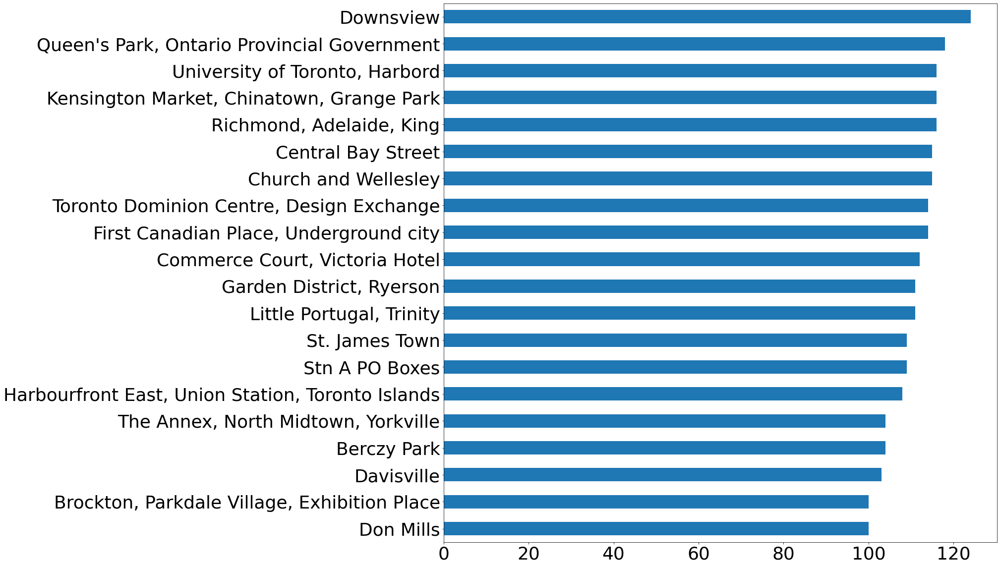

In [27]:
#Neighbourhoods with most restaurants
toronto_join['Neighbourhood'].value_counts().sort_values(ascending=True).tail(20).plot(kind='barh',figsize=(20,20),rot=0, fontsize=36 )


<AxesSubplot:>

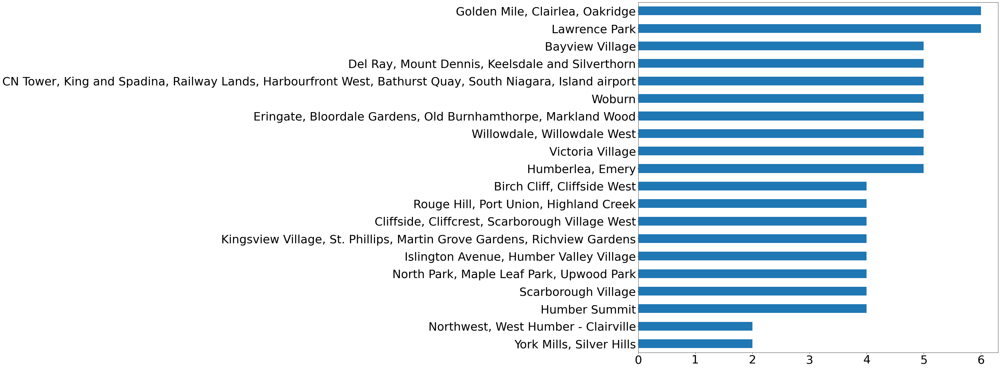

In [28]:
#Neighbourhoods with least restaurants
toronto_join['Neighbourhood'].value_counts().sort_values(ascending=True).head(20).plot(kind='barh',figsize=(20,20),rot=0, fontsize=36 )


<AxesSubplot:>

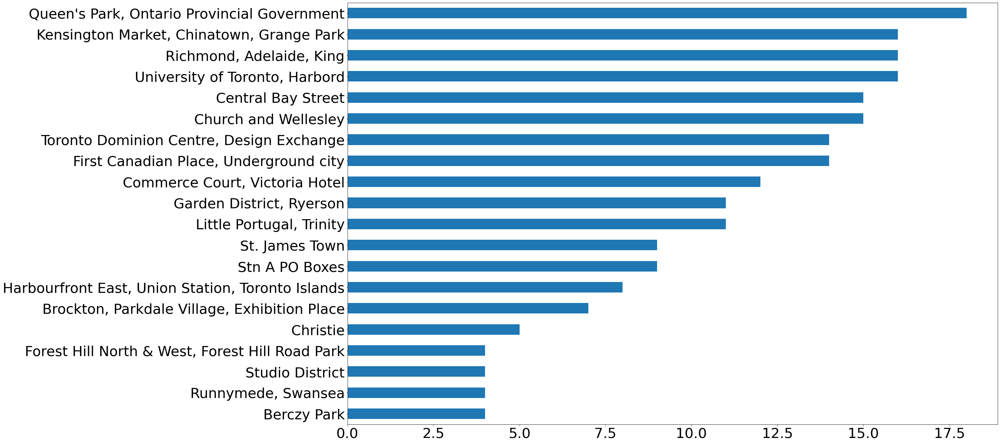

In [29]:
#Neighbourhoods with most Ice Cream Shops
venues_df2['Neighbourhood'].value_counts().sort_values(ascending=True).tail(20).plot(kind='barh',figsize=(30,20),rot=0, fontsize=36)

<AxesSubplot:>

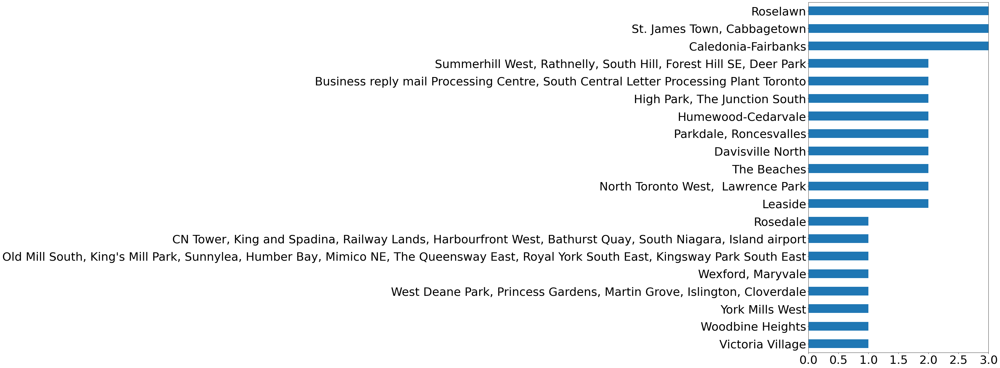

In [30]:
#Neighbourhoods with least Ice Cream Shops
venues_df2['Neighbourhood'].value_counts().sort_values(ascending=True).head(20).plot(kind='barh',figsize=(10,20),rot=0, fontsize=36,xlim=[0,3])

In [31]:
#Neighbourhoods with no ice cream shops
No_icecream=pd.merge(toronto_data['Neighbourhood'],venues_df2['Neighbourhood'],on='Neighbourhood',how='left',indicator=True)
No_icecream=No_icecream[No_icecream['_merge']=='left_only']
No_icecream['Neighbourhood'].unique()

array(['Malvern, Rouge', 'Rouge Hill, Port Union, Highland Creek',
       'Guildwood, Morningside, West Hill', 'Woburn', 'Cedarbrae',
       'Scarborough Village',
       'Kennedy Park, Ionview, East Birchmount Park',
       'Golden Mile, Clairlea, Oakridge',
       'Cliffside, Cliffcrest, Scarborough Village West',
       'Birch Cliff, Cliffside West',
       'Dorset Park, Wexford Heights, Scarborough Town Centre',
       'Agincourt', "Clarks Corners, Tam O'Shanter, Sullivan",
       "Milliken, Agincourt North, Steeles East, L'Amoreaux East",
       "Steeles West, L'Amoreaux West", 'Upper Rouge',
       'Hillcrest Village', 'Fairview, Henry Farm, Oriole',
       'Bayview Village', 'York Mills, Silver Hills',
       'Willowdale, Newtonbrook', 'Willowdale, Willowdale West',
       'Parkwoods', 'Bathurst Manor, Wilson Heights, Downsview North',
       'Northwood Park, York University', 'Downsview',
       'Parkview Hill, Woodbine Gardens', 'Thorncliffe Park',
       'East Toronto, Broadv

<AxesSubplot:>

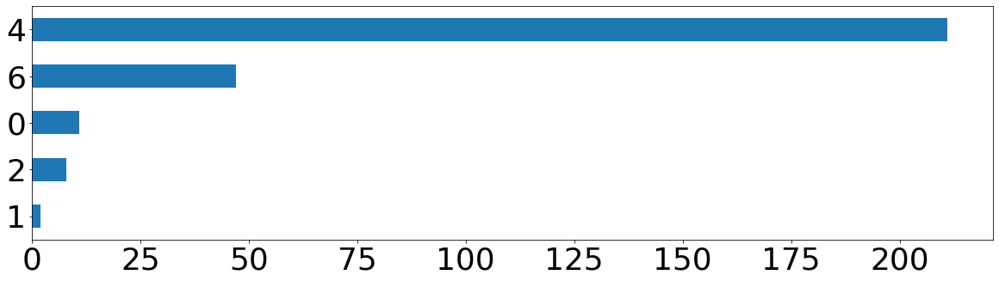

In [32]:
#Clusters with most Ice Cream Shops
icecream_cluster['Cluster Labels'].value_counts().sort_values(ascending=True).plot(kind='barh',figsize=(20,5),rot=0, fontsize=36)

In [33]:
#Clusters with no ice cream shops
No_icecream=pd.merge(toronto_data['Cluster Labels'],icecream_cluster['Cluster Labels'],on='Cluster Labels',how='left', indicator=True)
No_icecream=No_icecream[No_icecream['_merge']=='left_only']
No_icecream['Cluster Labels'].unique()

array([5, 3], dtype=int32)

In [34]:
# Neighbourhoods count of Ice Cream Shops
N_icecream= venues_df2.groupby(["Neighbourhood"]).count().reset_index().rename(columns={"VenueCategory": "Ice Cream Count"}, inplace=False)[["Neighbourhood","Ice Cream Count"]]
# Clusters count of Restaurants
C_restaurants=toronto_join.groupby(["Cluster Labels"]).count().reset_index().rename(columns={"Neighbourhood": "Restaurant Count"}, inplace=False)[["Cluster Labels","Restaurant Count"]]
# Clusters count of Restaurants
N_restaurants=toronto_join.groupby(["Neighbourhood"]).count().reset_index().rename(columns={"VenueCategory": "Restaurant Count"}, inplace=False)[["Neighbourhood","Restaurant Count"]]
# Clusters count of Ice Cream Shops
C_icecream=icecream_cluster.groupby(["Cluster Labels"]).count().reset_index().rename(columns={"Neighbourhood": "Ice Cream Count"}, inplace=False)[["Cluster Labels","Ice Cream Count"]]
#Creating a df for cluster ratio
Cluster_ratio=pd.merge(C_icecream,C_restaurants,on='Cluster Labels',how='left')
#Creating a df for neighbourhood ratio
Neighbourhood_ratio=pd.merge(N_icecream,N_restaurants,on='Neighbourhood',how='left')

In [35]:
#Calculating the cluster opportunity score
Cluster_ratio['Ice Cream Ratio'] = Cluster_ratio['Ice Cream Count']/Cluster_ratio['Restaurant Count']
Cluster_ratio['% of Total']=Cluster_ratio['Restaurant Count']/total_restaurants
Cluster_ratio['Opportunity Score']= Cluster_ratio['Ice Cream Ratio']/Cluster_ratio['% of Total']
Cluster_ratio.sort_values('Opportunity Score',ascending=True).head(10)

,Cluster Labels,Ice Cream Count,Restaurant Count,Ice Cream Ratio,% of Total,Opportunity Score
3,4,211,2400,0.087917,0.642915,0.136747
0,0,11,385,0.028571,0.103134,0.277032
1,1,2,146,0.013699,0.039111,0.350253
4,6,47,672,0.069940,0.180016,0.388524
2,2,8,238,0.033613,0.063756,0.527223


In [36]:
#Calculating the neighbourhood opportunity score
Neighbourhood_ratio['Ice Cream Ratio'] = Neighbourhood_ratio['Ice Cream Count']/Neighbourhood_ratio['Restaurant Count']
Neighbourhood_ratio['% of Total']=Neighbourhood_ratio['Restaurant Count']/total_restaurants
Neighbourhood_ratio['Opportunity Score']= Neighbourhood_ratio['Ice Cream Ratio']/Neighbourhood_ratio['% of Total']
Neighbourhood_ratio.sort_values('Opportunity Score',ascending=True).head(10)

,Neighbourhood,Ice Cream Count,Restaurant Count,Ice Cream Ratio,% of Total,Opportunity Score
10,Davisville North,2,84,0.023810,0.022502,1.058107
11,Don Mills,3,100,0.030000,0.026788,1.119900
45,"Willowdale, Willowdale East",3,96,0.031250,0.025717,1.215169
0,Berczy Park,4,104,0.038462,0.027860,1.380547
37,"The Annex, North Midtown, Yorkville",4,104,0.038462,0.027860,1.380547
9,Davisville,4,103,0.038835,0.027592,1.407484
35,Studio District,4,92,0.043478,0.024645,1.764178
17,"High Park, The Junction South",2,62,0.032258,0.016609,1.942248
39,"The Danforth West, Riverdale",4,87,0.045977,0.023306,1.972784
25,"Parkdale, Roncesvalles",2,61,0.032787,0.016341,2.006450


In [37]:
#Import geospatial data for Toronto
import json 
!wget -q -O 'toronto.json' https://raw.githubusercontent.com/ag2816/Visualizations/master/data/Toronto2.geojson #uncomment if need to import data
with open('toronto.json') as json_data:
        ontario_geo = json.load(json_data)

In [38]:
x = np.arange(kclusters)
ys = [i+x+(i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

map_toronto = folium.Map(location=[latitude, longitude], zoom_start=11)
map_toronto.choropleth(geo_data=ontario_geo,
    data = toronto_postal,
    columns=['Postal Code','Cluster Labels'],
    key_on='feature.properties.CFSAUID',
    fill_color= 'Accent',
    fill_opacity=0.7, 
    line_opacity=0.2) 
for lat, lon, poi, cluster in zip(toronto_join['VenueLatitude'], toronto_join['VenueLongitude'], toronto_join['VenueName'], toronto_join['Cluster Labels']):
    label = folium.Popup(str(poi) + ' - Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat,lon],radius=.5,popup=label,color=rainbow[cluster-1],fill=True,fill_color=rainbow[cluster-1],fill_opacity=0.7).add_to(map_toronto)
for lat, lon, poi, cluster in zip(icecream_cluster['VenueLatitude'], icecream_cluster['VenueLongitude'], icecream_cluster['VenueName'], icecream_cluster['Cluster Labels']):
    label = folium.Popup(str(poi)+ ' - Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat,lon],radius=3,popup=label,color="black",fill=True,fill_color="black",fill_opacity=0.7).add_to(map_toronto)
map_toronto


In [39]:
# Save map to HTML
map_toronto.save("cluster.html")

In [40]:
#Create a df for plotting postal codes against opportunity score
Opportunity_score = pd.merge(Neighbourhood_ratio,toronto_data,on='Neighbourhood',how='left')

In [41]:
#Plot restaurants and ice cream shops over choropleth by opportunity score
x = np.arange(kclusters)
ys = [i+x+(i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

map_toronto = folium.Map(location=[latitude, longitude], zoom_start=11)
map_toronto.choropleth(geo_data=ontario_geo,
    data = Opportunity_score,
    columns=['Postal Code','Opportunity Score'],
    key_on='feature.properties.CFSAUID',
    fill_color= 'Accent',
    fill_opacity=0.7, 
    line_opacity=0.2) 
for lat, lon, poi, cluster in zip(toronto_join['VenueLatitude'], toronto_join['VenueLongitude'], toronto_join['VenueName'], toronto_join['Cluster Labels']):
    label = folium.Popup(str(poi) + ' - Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat,lon],radius=.5,popup=label,color=rainbow[cluster-1],fill=True,fill_color=rainbow[cluster-1],fill_opacity=0.7).add_to(map_toronto)
for lat, lon, poi, cluster in zip(icecream_cluster['VenueLatitude'], icecream_cluster['VenueLongitude'], icecream_cluster['VenueName'], icecream_cluster['Cluster Labels']):
    label = folium.Popup(str(poi)+ ' - Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker([lat,lon],radius=3,popup=label,color="black",fill=True,fill_color="black",fill_opacity=0.7).add_to(map_toronto)
map_toronto


In [42]:
# Save map to HTML
map_toronto.save("opportunity score.html")